# ProGym - New Facility near Phoenix, AZ

ProGym is a fictional physical fitness and training company based in Los Angeles, CA.  The ProGym Business Model caters primarily to physicians and members of the professional medical community.  The ProGym management team has been growing the company steadilly since 2014 and believes that Phoenix, AZ is the best location for the next facility.

BusiHAX is a fictional Business Intellegence firm based in Tucson, AZ.  One of the core offerings by BusiHAX is understanding business environments.  BusiHAX mission is simple - we turn data into intelligence, and intelligence into success.  For almost 90 days we have been using our intelligence assets to help businesses win.


## Business Challenge
BusiHAX has been hired by ProGym to help determine the best location for a new facility in the metro Phoenix area.  ProGym has a deep understanding of their highest value facilities and what makes them profitable and successful. From their most successful facilities, ProGym as developed a **Facility Profile**. ProGym understands their clientele very well and have developed a very specific **Client Profile** based on their business model.  The challenge for BusiHAX will be to combine data about the Phoenix Metro Area with the ProGym **Client and Facility Profiles** to find the best location candidates.

## Stakeholders
Interested parties for the ProGym-Phoenix project include the ProGym facilities team and the ProGym executive management team.

## The Data
- FourSquare.com - Public venue information service:  https://developer.foursquare.com/docs/places-api/
- US Census Data - https://data.census.gov
    - Age/Sex by ZIP Code - table **S0101**
    - Education by ZIP Code - table **S1501**
    - Income by ZIPcode - table **B19001**
- ZIP Code Latitude & Longitude: https://public.opendatasoft.com/explore/dataset/us-zip-code-latitude-and-longitude/table/
- ZIP Code Geo Boundries https://catalog.data.gov/dataset/tiger-line-shapefile-2019-2010-nation-u-s-2010-census-5-digit-zip-code-tabulation-area-zcta5-na

### ProGym Facility Profile
ProGym facilities located near hospitals, doctor's offices and other professional buildings have proven to be the most successful.  Additionally, ProGym has noted that locations in close proximity to fine dining establishments tend to sell more personal training services.  This correlation is strong enough to indicate that some weight should be given to proximity to fine dining.  
- From the FourSquare.com Dataset API, will extract the following for each ZIPcode (to allow an analysis of the ProGym Facility Profile):
  - Hospital Count
  - Doctors office Count
  - Fine Dining Restaurant Count

### ProGym Client Profile
ProGym clientle are primarily medical professionals.  This leads to the following demographics:  age, education level, income level, and others.

Each dataset for this exploration consists of records indexed by a 5-digit ZIPcode. 
- From the US Census Dataset, will extract the following for each ZIPcode:
  - Total age 35-55
  - Age 35-55 with Bachleors Degree
  - Age 35-55 with Bachleors Degree or higher
  - Age 35-55 Professional Degree 
- From the Internal Revenue Service Dataset, income level for each ZIPcode will be added to the dataset
- From Zillow Dataset, the current median home value will be added to the dataset

- Each record in the new dataset will look like the following (to allow an analysis of the ProGym client profile):
  - ZIP Code ( Index )
  - Total age 35-55
  - Age 35-55 with Bachelors Degree - count
  - Age 35-55 with Bachelors Degree or higher - count
  - Age 35-55 Professional Degree - count
  - Median Income
  - Median Home Value  

## Data Use
The datasets will be combined using the ZIP code as the index.  The data will then be used to create Chloropoeth maps to better understand the populuation distribution based on each criteria.  Next the data will be clustered using both K-Means and Support Vector methods to understand which ZIP Code groups best match all of the required criteria.

#### GEOJSON data was gleened from this article:
https://medium.com/dataexplorations/generating-geojson-file-for-toronto-fsas-9b478a059f04


## Data Wrangling
The data for this evaluation come from several sources.  For analysis, each dataset needs to be cleaned up an normalized.  The following code produces Pandas DataFrames with a ZIP code index for each dataset.

In [346]:
import pandas as pd
import numpy as np
import folium
import requests
import pickle
import time
from folium.plugins import MarkerCluster
import docx

# All of our data will be relating to the postal codes (ZIP Codes) in Maricopa County (i.e. Phoenix Metro Area), AZ, USA
#maricopa_zips = ["85027","85023","85022","85306","85053","85310","85308","85382","85024","85050","85032","85254","85260","85054","85381","85351","85335","85363","85345","85304","85029","85051","85302","85021","85020","85028","85253","85251","85016","85014","85015","85013","85012","85017","85019","85301","85303","85305","85307","85392","85035","85257","85018","85009","85031","85033","85037","85256","85250","85258","85034","85008","85006","85007","85003","85004","85043","85041","85353","85323","85338","85395","85204","85286","85248","85048","85226","85044","85042","85040","85282","85281","85205","85207","85140","85212","85296","85284","85283","85249","85203","85213","85215","85259","85201","85202","85224","85225","85233","85234","85206","85210","85209","85208","85295","85297","85298","85379","85375","85373","85383","85268","85255","85339","85355","85388","85374","85340","85387","85086","85085","85083","85266","85331","85045"]
maricopa_zips = ["85027","85023","85022","85306","85053","85310","85308","85382","85024","85050","85032","85254","85260","85054","85381","85351","85335","85363","85345","85304","85029","85051","85302","85021","85020","85028","85253","85251","85016","85014","85015","85013","85012","85017","85019","85301","85303","85305","85307","85392","85035","85257","85018","85009","85031","85033","85037","85256","85250","85258","85034","85008","85006","85007","85003","85004","85043","85041","85353","85323","85338","85395","85204","85286","85248","85048","85226","85044","85042","85040","85282","85281","85205","85207","85212","85296","85284","85283","85249","85203","85213","85215","85259","85201","85202","85224","85225","85233","85234","85206","85210","85209","85208","85295","85297","85298","85379","85375","85373","85383","85268","85255","85339","85355","85388","85374","85340","85387","85086","85085","85083","85266","85331","85045"]
# Phoenix latitude and longitude values
Phx_Latitude = 33.4484
Phx_Longitude = -112.0740
Phoenix_Geo_JSON = r'data/progym_metro_phoenix.geojson' # geojson file

# Clean up some pandas defaults
pd.options.display.float_format = "{:,.2f}".format # Limit Pandas Floats to 2 decimals

## FourSquare API Setup

In [347]:
# Define and download the wiki page
CLIENT_ID = '5HPET1K2F5KSIMNIAOJSTRSQBWW3CO5YTVYI5UQDO0DACZLH' # your Foursquare ID
CLIENT_SECRET = 'MDZZBZNLQ0XDHUCY43AVPJDXXYPYOKYFZKT4SYZRFSONU1S5' # your Foursquare Secret
VERSION = '20180604'
LIMIT = 50

In [348]:
# A dict to hold values returned from the FourSquare API
venue_dict = {} # This will be populated with arrays for each of 'venue_cols' 
venue_cols = ["ZIP", "id", "Name", "Latitude", "Longitude", "Category", "Search", "Price Tier", "Rating", "Likes"]

# The FourSquare API returns many irrelivant categories - this is the sort list of categories in which we're interested
keep_med_cats  = ["Hospital","Dentist's Office","Doctor's Office","Emergency Room","Medical Center"]
keep_food_cats = ["Restaurant","Wine Bar"]

## Map ZIP Codes to Latitude/Longitude
This exploration makes extensive use of ZIP Code Lat/Long mappings, so we'll define a dataframe here.

In [349]:
zip_geo_df = pd.read_csv("data/us-zip-code-latitude-and-longitude.csv",sep=';', dtype={"Zip":"object","City":"object","State":"object","Latitude":"float64","Longitude":"float64","Timezone":"int64","Daylight savings time flag":"int64","geopoint":"object"})

In [350]:
zip_geo_df.dtypes

Zip                            object
City                           object
State                          object
Latitude                      float64
Longitude                     float64
Timezone                        int64
Daylight savings time flag      int64
geopoint                       object
dtype: object

## Function to get and prep FourSquare Data
- This function reads from the FourSqure API and prepares a dictionary.
- The dictionary will be translated into a Pandas DataFrame later.
- This routine finds medical facilities for each zip code and restaurants in the 3-4 (more expensive) price range.
- This routne takes a very long time to run - so the results have been saved in a Pickle file for quick access

In [106]:
# Cached data - so we can limit premium API calls
venue_dict = pickle.load(open("data/venues.pkl", 'rb'))

In [107]:
# This function takes a data dictionary, a list of zip codes, and a search query
# Using the FourSquare REST API, we'll assemble of list of venues 
# the dataset is defined by 'venue_cols' defined above.  
# Venues are stored in the dataset only if they match a category in 'keep_categories'
# This is soooo much easier with the FourSquare Python API: https://pypi.org/project/foursquare/
# 

def get_venues_by_zip(the_dict, zip_list, search_query):
    
    # Food and Medical have slightly different execution paths so, it's important
    # to distinguish between the two query types
    if search_query in ["Hospital", "Doctor's Office"]:
        query_type = 'Medical'
    elif search_query in ['Restaurant']:
        query_type = 'Food'
    else:
        raise QuerryError

    if the_dict == {}:  # Needs to be initialized!
        the_dict = {x:[] for x in venue_cols}
    
    radius = 20000
    LIMIT = 50
    premium_calls = 0
    duplicate_venue_hits = 0
    unique_venue_hits = 0

    for postal_code in zip_list:
        
        if query_type == 'Medical':
            # Set the medical facility search url
            url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&near={}&v={}&query={}&limit={}&radius={}'.format(CLIENT_ID, CLIENT_SECRET, postal_code, VERSION, search_query, LIMIT, radius)
        else:
            # Set the Restaurant/Price Query
            # FourSquare rates prices on a scale of 1-4, we're interested only in '3&4' level pricing
            url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&near={}&v={}&query={}&limit={}&radius={}&price=3,4'.format(CLIENT_ID, CLIENT_SECRET, postal_code, VERSION, search_query, LIMIT, radius)

        results = requests.get(url).json()
        
        if query_type == 'Medical':
            try:
                venues  = results['response']['venues'] 
            except KeyError:
                continue  # We've got nothing to work with go to the next zip!
        else:
            try:
                venues = []
                match_list = results['response']['groups'][0]['items']
                for match in match_list:
                    venues.append(match['venue'])
            except KeyError: # There are no venues that match this query, move along
                continue
        for venue in venues:    
            if venue['id'] in the_dict['id']:  # We have a duplicate venue
                duplicate_venue_hits += 1
                continue
            else:
                unique_venue_hits += 1
            
            # Skip venues that don't have a category or have the wrong category
            if len(venue['categories']) == 0 : continue
                
            # Have a category - let's see if it's one that we care about
            the_cat = venue['categories'][0]['name']
            
            # There's not much elegance to the catagory logic so, I just hammered it out in long-hand... 
            # We have medical venues and food venues - they are treated differently
            # So we'll set a flag for each
            
            # Medical Categories that are relevant
            med_keeper = (the_cat in keep_med_cats)
            
            # Food Catetories that are relevant
            food_keeper = ((the_cat.endswith('Restaurant')) or (the_cat == 'Wine Bar') or (the_cat == 'Food')) and (the_cat != 'Fast Food Restaurant')
                 
            if not ( med_keeper or food_keeper):
                continue # We don't have a relevant catagory - move along
                
            # We have a good category - add it to the list
            the_dict["Category"].append(the_cat) 
            
            zip_code = venue['location']['postalCode'] if 'postalCode' in venue['location'] else postal_code
            the_dict['ZIP'].append(zip_code)
            
            the_dict["id"].append(venue["id"])
            the_dict["Name"].append(venue["name"])
            the_dict["Latitude"].append(venue['location']['lat'])
            the_dict["Longitude"].append(venue['location']['lng'])
            
            price_tier   = np.nan
            venue_rating = np.nan
            venue_likes  = np.nan

            if food_keeper: # We need to get the rating and price range
                url = "https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}".format(venue["id"],CLIENT_ID, CLIENT_SECRET, VERSION)
                # Get a JSON response from FourSquare
                premium_calls += 1
                results = requests.get(url).json()
                
                venue = results['response']['venue']
                # This is a bit ugly - but only way to check if a 
                try:
                    price_tier = venue['price']['tier']
                except KeyError:
                    pass
                try:
                    venue_rating = venue['rating']
                except KeyError:
                    pass
                try:
                    venue_likes = venue['likes']['count']
                except KeyError:
                    pass   
                 
            the_dict["Price Tier"].append(price_tier)
            the_dict["Rating"].append(venue_rating)
            the_dict["Likes"].append(venue_likes)
            the_dict["Search"].append(search_query)
             
    print("Premium Calls:   {0}".format(premium_calls))
    print("Unique Venues:   {0}".format(unique_venue_hits))
    print("Duplicate Venus: {0}".format(duplicate_venue_hits))
    return the_dict


In [108]:

venue_dict = get_venues_by_zip(venue_dict, maricopa_zips, "Hospital")
venue_dict = get_venues_by_zip(venue_dict, maricopa_zips, "Doctor's Office")
venue_dict = get_venues_by_zip(venue_dict, maricopa_zips, "Restaurant")

Premium Calls:   0
Unique Venues:   3446
Duplicate Venus: 2261
Premium Calls:   0
Unique Venues:   4901
Duplicate Venus: 849
Premium Calls:   5
Unique Venues:   661
Duplicate Venus: 1706


In [110]:
# Persist the venues data set for later...
file = open('data/venues.pkl', 'wb')
# dump information to that file
pickle.dump(venue_dict, file)
# close the file
file.close()

### Reading data from a stored run saves about 15 minutes :)

In [284]:
# The function above takes very long time to run - so to save some time, I've
# saved the data in a pickle file
venue_dict = pickle.load(open("data/venues.pkl", 'rb'))

In [285]:
# Load the Venue Data Into the Data Frame
venues_df = pd.DataFrame(data=venue_dict,columns=venue_cols)

# Update the index
venues_df.reset_index(inplace=True)

In [286]:
venues_df.shape

(420, 11)

#### Exclude ZIP Codes that are not in the ZIP List

In [287]:
tmp_df = venues_df[venues_df['ZIP'].isin(maricopa_zips)]
venues_df = tmp_df.copy()
venues_df.shape

(395, 11)

### Function to generate Choropleth Map
This analysis makes extensive use of this type of map, using colored ZIP Code overlays to visualize the data sets

In [288]:
def gen_zip_map(the_title, the_df, the_column, the_fill, text_color, do_labels):
    # This function builds and returns a map with zipcode overlays
    # The color is based on values from 'the_column' which is a named column
    # in the_data_df
    the_map = folium.Map(location=[Phx_Latitude, Phx_Longitude], zoom_start=10)
    
    # Add the choropleth overlay
    the_map.choropleth(
        geo_data=Phoenix_Geo_JSON,
        data=the_df,
        columns=['ZIP', the_column],
        key_on='feature.properties.ZCTA5CE10',
        fill_color=the_fill, 
        fill_opacity=0.7, 
        line_opacity=0.2,
        legend_name=the_title
    )

    if do_labels:
        # zip_geo_df maps zip codes to lat/long on the map
        # If requested, we'll label each zip code
        for i in range(0,len(the_df)):
            try:
                (the_zip,lat,long) = zip_geo_df[zip_geo_df['Zip'].isin(the_df['ZIP'].values)].iloc[[i]][['Zip','Latitude','Longitude']].values[0]
                the_zip = str(the_zip)

                folium.Marker(
                    location=[lat,long],
                    icon=folium.DivIcon("<div style=\"color:" + text_color + "\">" + the_zip + "</div>"),
                ).add_to(the_map)
            except IndexError:
                print("Index error prior to: index:{}  zip: {} lat:{}  long:{}".format(i,the_zip,lat,long))
                continue

    return the_map

## A function to group ZIP Codes by 4 Quadrants (NE, SE, NW, SW)

In [523]:
def get_quad(index, df):
    (the_zip, lat, long) = df.iloc[index][['ZIP','Latitude','Longitude']].values
    N = True
    E = True

    if lat > 33.45635:
        N = True
    else:
        N = False
    if long >= -112.07057:
        E = True
    else:
        E = False
        
    if (N and E): 
        quad = 'ne'
        color = 1
    if (N and (not E)): 
        quad = 'nw'
        color = 0
    if ((not N) and E): 
        quad = 'se'
        color = 2
    if ((not N) and (not E)): 
        quad = 'sw'
        color = 3
    
    return (the_zip, quad, lat, long, color)

## ZIP Code Anomolies and Outliers
During the data analysis a couple of interesting issues were uncovered regarding ZIP codes **85309** and **85253**.  85309 is Luke Air Force Base.  The US Census numbers are no available for this ZIP Code.  85253 is Paradise Valley.  The median home values and income for this ZIP code are about 5x the median value for the rest of Phoenix.

## Duplicate Venue Issues 
The data pull from FourSquare has a significant number of duplicate entries for medical venues.  For example, Phoenix Children's Hosptial (PCH) has one entry for each department.  The data from FourSquare contained almost 20 entires for PCH at the same location.  and an individual doctor office at a medical center.  The nature of the duplicate names is such that it was more efficient to manually select a list of faclities to keep than to try to filter them programatically.  Even after the list was trimmed, duplicates still existed - so I had do remove by the entry id.

In [289]:
venues_df.head(2)

,index,ZIP,id,Name,Latitude,Longitude,Category,Search,Price Tier,Rating,Likes
0,0,85027,4d9604700caaa14398a16cb3,Mayo Hospital Emergency Room,33.68,-112.09,Emergency Room,Hospital,nan,nan,nan
1,1,85020,4be6158dcf200f47b335143c,John C. Lincoln North Mountain Hospital,33.57,-112.07,Hospital,Hospital,nan,nan,nan


#### From the venue_df, we need to get a list of unique hosptals and medical centers

In [290]:
# Build up a list of criteria for dropping duplicate venue entries

# Categories to keep
med_cats  = ["Hospital","Medical Center"]
# Names To keep
keep_name_list = ["Barrow Neurological Institute at Phoenix Children's Hospital", "Cardon Children's Medical Center", "Phoenix Children's Hospital", "Saint Luke's Hospital & Medical Center", "St. Joseph's Childrens Hospital", "Tempe St. Luke's Hospital", "Abrazo Arizona Heart Hospital", "Abrazo West Campus", "Arizona Heart Institute Hospital 2nd Floor", "Arizona Orthopedic and Surgical Specialty Hospital", "Arizona Spine & Joint Hospital", "Arrowhead Hospital Cath Lab", "Arrowhead Hospital", "Banner Baywood Medical Center", "Banner Boswell Medical Center", "Banner Del E Webb Medical Center", "Banner Desert Medical Center", "Banner Desert Samaritan Hospital", "Banner Estrella Medical Center", "Banner Gateway Medical Center", "Banner Heart Hospital", "Banner Ironwood Medical Center", "Banner – University Medical Center Phoenix", "Chandler Regional Hospital", "Dignity Health Arizona General Hospital - Mesa", "Dignity Health Arizona General Hospital", "Egan Hospital", "Gilbert Hospital", "HonorHealth Deer Valley Medical Center", "HonorHealth Greenbaum Surgical Specialty Hospital", "HonorHealth Scottsdale Osborn Medical Center", "HonorHealth Scottsdale Shea Medical Center", "Hospital Room 3215", "Hospitals", "John C. Lincoln North Mountain Hospital", "Kindred Hospital Arizona - Northwest Phoenix", "Kindred Hospital Arizona - Phoenix", "Kindred Hospital Arizona - Scottsdale", "Los Ninos Hospital", "MOLLY ANNS OFFICE", "Maricopa County Hospital Patient Registration", "Maricopa Hospital", "Maternity/OB Triage-Thunderbird Hospital", "Mayo Clinic Hospital - Neurosurgery Dept", "Mayo Clinic", "Mercy Gilbert Medical Center", "Mercy Hospital", "Mountain Vista Hospital", "Mountain Vista Medical Center", "New York Methodist Hospital", "O:A:S:I:S Hospital", "Oasis Behavioral Health Hospital", "Oasis Hospital", "Paradise Valley Hospital", "Phoenix Baptist Hospital", "Phoenix Children’s Hospital", "Phoenix ER & Medical Hospital", "Phoenix Indian Medical Hospital", "Phoenix Memorial Hospital", "Phoenix VA Hospital Radiology", "Phoenix VA Hospital Ward 3B", "Phoenix childrens hospital", "Promise Hospital", "Restora Hospital of Mesa", "Royal Bolton Hospital ( Delivery Suit )", "Scottsdale Medical Imaging- Westland Office Suites", "Select Specialty Hospital Osborn", "Silent Hill: Alchemilla Hospital", "Specialty Hospital Of Phoenix", "St Josephs Hospital Radiology Schedulers", "St.Josephs Hospital and Medical Center", "Surgical Specialty Hospital Of Arizona", "Thompson Peak Hospital", "Thunderbird Hospital", "Trilium Specialty Hospital", "Trillium Specialty Hospital", "Turquoise Clinic Phoenix VA Hospital", "University of Arizona Cancer Center at Dignity Health", "Valley Hospital PHP & IOP Facility", "West Valley Hospital", "banner desert hospital", "scottsdale osborn hospital", "thompson peak hospital"]

# Build up the de-dup list
dedup_med_df = venues_df[venues_df['Name'].isin(keep_name_list)]

# A manually constructed list of duplicates that could not be programatically detected
duplicate_ids = ["4f00890f0aaffcf6f50e5e95","57ab1389498e8fc30b854ff9","5efcb8ce5c39c20007e75849","4febe7e8e4b0a742364a1bf0","4c8812f7a0ffb60ce4411fc5","5e989b9d7c202400089dcf74","500d87d01648cb60d50c505f","4b6af6aff964a52045e92be3","5138290ae4b0aeb542a6c26b","5690a5d6498eb438c88f0240","515dfcab498e87b365fa29a8","53b1a2bc498e2838daa1c0b5","4a370afcf964a520279e1fe3"]


In [291]:
# Get a list of indexs to drop
drop_indexes = dedup_med_df[dedup_med_df['id'].isin(duplicate_ids)].index

# Drop the duplicate rows
tmp_df = dedup_med_df.drop(drop_indexes)

In [292]:
# Grab a 'clean' copy and delete the temp data frame
dedup_med_df = tmp_df.copy()
del tmp_df

#### The goal here is to build a data frame consisting of a ZIP Code and a count of unique medical faclities in that ZIP

In [293]:
# med_df will be a dataframe with zips and counts
med_df = dedup_med_df[dedup_med_df['Name'].isin(keep_name_list)][['ZIP','Name']].groupby(['ZIP']).count().rename(columns={'Name':'Med Count'})
med_df.reset_index(inplace=True)
med_df.sort_values(by=['Med Count'], ascending=False, inplace=True)

### 
## Visualizations regarding the ProGym Facility Profile
### Top 5 Medical Facility Density per ZIP Code

In [537]:
med_df.head(6)

,ZIP,Med Count
17,85206,5
7,85016,5
40,85395,3
27,85255,3
6,85015,3
25,85251,3


In [559]:
top5_med_map = gen_zip_map('Top 5 Medical Facility Density ZIP Codes', med_df.head(10), 
                           'Med Count', 'YlGn', 'black', True)
top5_med_map

## Top Tier Restaurants

In [296]:
# Select only the "4" price tier
top_restaurants = venues_df[venues_df['Price Tier'] == 4.0][['Name','Latitude','Longitude','ZIP']]

top_rant_zips_df = top_restaurants[['ZIP','Name']].groupby(['ZIP']).count().rename(columns={'Name':'Restaurant Count'})
top_rant_zips_df.reset_index(inplace=True)
top_rant_zips_df.sort_values(by="Restaurant Count", ascending=False, inplace=True)
top_rant_zips_df.head(3)

,ZIP,Restaurant Count
7,85254,4
6,85253,3
0,85016,2


In [297]:
the_title = 'Phoenix Top Tier Restaurant Density'
the_df = top_rant_zips_df # sorted by 'Restaurant Count'
top_tier_restaurant_map = gen_zip_map(the_title, the_df, 'Restaurant Count', 'YlGn', 'black', True)

# Add some marker clusters for clarity
marker_cluster = MarkerCluster().add_to(top_tier_restaurant_map)

# Add a marker group the top restaurants
for i in range(0,len(top_restaurants)):

    (rname, lat, long, the_zip) = top_restaurants.iloc[[i]].values[0]
    rname = rname.replace("'","")
    
    folium.Marker(
        location=[lat,long],
        popup=rname,
        icon=folium.Icon(color='blue'),
    ).add_to(marker_cluster)
    
top_tier_restaurant_map

## 
## Prepare US Census Tables
Tables from https://data.census.gov are over 300 columns - of which we require only a few.  In this section we'll clean up 

### US Census Population by Age & ZIP Code - The Target Age Group
- https://census.data.gov - table **S0101** 
- Direct Download [link](https://data.census.gov/cedsci/map?g=8600000US85027,85023,85022,85306,85053,85310,85308,85382,85024,85050,85032,85254,85260,85054,85381,85351,85335,85363,85345,85304,85029,85051,85302,85021,85020,85028,85253,85251,85016,85014,85015,85013,85012,85017,85019,85301,85303,85305,85307,85392,85035,85257,85018,85009,85031,85033,85037,85256,85250,85258,85034,85008,85006,85007,85003,85004,85043,85041,85353,85323,85338,85395,85204,85286,85248,85048,85226,85044,85042,85040,85282,85281,85205,85207,85140,85212,85296,85284,85283,85249,85203,85213,85215,85259,85201,85202,85224,85225,85233,85234,85206,85210,85209,85208,85295,85297,85298,85379,85375,85373,85383,85268,85255,85339,85355,85388,85374,85340,85387,85086,85085,85083,85266,85331,85045&hidePreview=false&tid=ACSST5Y2018.S0101&cid=S0101_C01_001E&vintage=2018&layer=VT_2018_860_00_PY_D1&mode=selection&t=Age%20and%20Sex)

In [298]:
pop_by_age_df = pd.read_csv("data/ACSST5Y2018.S0101_data_with_overlays_2020-07-11T145527.csv",skiprows=1,index_col=None)

#### Drop columns that are not required

In [299]:
# These are the columns that are relevant for this investigation
keep_cols = ["Geographic Area Name","Estimate!!Total!!Total population!!AGE!!35 to 39 years","Estimate!!Total!!Total population!!AGE!!40 to 44 years","Estimate!!Total!!Total population!!AGE!!45 to 49 years","Estimate!!Total!!Total population!!AGE!!50 to 54 years"]

# Drop irrelevant column
pop_by_age_df.drop([col for col in pop_by_age_df.columns if col not in keep_cols],axis=1,inplace=True)

# ZIP Code is the last 5 digits of Geographic Area Name
pop_by_age_df["Geographic Area Name"] = pop_by_age_df["Geographic Area Name"].str[-5:] 
pop_by_age_df.rename(columns={"Geographic Area Name":"ZIP"},inplace=True)
pop_by_age_df.set_index('ZIP')
# Sum the numeric data - 3 columns representing ages 35-50
pop_by_age_df['Age Pop'] = pop_by_age_df.sum(numeric_only=True,axis=1)

In [300]:
age_df = pop_by_age_df[["ZIP","Age Pop"]]

In [301]:
age_df.head(2)

,ZIP,Age Pop
0,85003,2734
1,85004,1259


### US Census Education Attainment by ZIP Code
- https://data.census.gov - Table **S1501** 
- Direct download [link](https://data.census.gov/cedsci/map?q=S1501&g=8600000US85027,85023,85022,85306,85053,85310,85308,85382,85024,85050,85032,85254,85260,85054,85381,85351,85335,85363,85345,85304,85029,85051,85302,85021,85020,85028,85253,85251,85016,85014,85015,85013,85012,85017,85019,85301,85303,85305,85307,85392,85035,85257,85018,85009,85031,85033,85037,85256,85250,85258,85034,85008,85006,85007,85003,85004,85043,85041,85353,85323,85338,85395,85204,85286,85248,85048,85226,85044,85042,85040,85282,85281,85205,85207,85140,85212,85296,85284,85283,85249,85203,85213,85215,85259,85201,85202,85224,85225,85233,85234,85206,85210,85209,85208,85295,85297,85298,85379,85375,85373,85383,85268,85255,85339,85355,85388,85374,85340,85387,85086,85085,85083,85266,85331,85045&hidePreview=false&tid=ACSST5Y2018.S1501&mode=selection&vintage=2018&layer=VT_2018_860_00_PY_D1&cid=S1501_C01_001E) - When the page loads, click on 'Educational Attainment' to see the distribution.

In [302]:
pop_by_edu_df = pd.read_csv("data/ACSST5Y2018.S1501_data_with_overlays_2020-07-11T143008.csv",skiprows=1,index_col=None)

In [303]:
# Same as above, drop the irrelevant columns, and clean up the ugly names
keep_cols = ["Geographic Area Name","Estimate!!Total!!Population 25 years and over!!Population 35 to 44 years!!Bachelor's degree or higher","Estimate!!Total!!Population 25 years and over!!Population 45 to 64 years!!Bachelor's degree or higher","Estimate!!Total!!Population 25 years and over!!Graduate or professional degree"]

# Drop irrelevant column
pop_by_edu_df.drop([col for col in pop_by_edu_df.columns if col not in keep_cols],axis=1,inplace=True)

# ZIP Code is the last 5 digits of Geographic Area Name
pop_by_edu_df["Geographic Area Name"] = pop_by_edu_df["Geographic Area Name"].str[-5:] 
pop_by_edu_df.rename(columns={"Geographic Area Name":"ZIP"},inplace=True)
pop_by_edu_df.set_index('ZIP')

# Sum the numeric data - 3 columns representing ages 35-50
pop_by_edu_df['Edu Pop'] = pop_by_edu_df.sum(numeric_only=True,axis=1)

In [304]:
edu_df = pop_by_edu_df[["ZIP","Edu Pop"]]

In [305]:
edu_df.head(2)

,ZIP,Edu Pop
0,85003,2610
1,85004,1317


### US Census Estimated Income Data
- https://data.census.gov - Table **B19001** - Filtered for ZIPcodes in Maricopa County, AZ
- Data download [link](https://data.census.gov/cedsci/map?q=B19001%3A%20HOUSEHOLD%20INCOME%20IN%20THE%20PAST%2012%20MONTHS%20%28IN%202018%20INFLATION-ADJUSTED%20DOLLARS%29&g=8600000US85027,85023,85022,85306,85053,85310,85308,85382,85024,85050,85032,85254,85260,85054,85381,85351,85335,85363,85345,85304,85029,85051,85302,85021,85020,85028,85253,85251,85016,85014,85015,85013,85012,85017,85019,85301,85303,85305,85307,85392,85035,85257,85018,85009,85031,85033,85037,85256,85250,85258,85034,85008,85006,85007,85003,85004,85043,85041,85353,85323,85338,85395,85204,85286,85248,85048,85226,85044,85042,85040,85282,85281,85205,85207,85140,85212,85296,85284,85283,85249,85203,85213,85215,85259,85201,85202,85224,85225,85233,85234,85206,85210,85209,85208,85295,85297,85298,85379,85375,85373,85383,85268,85255,85339,85355,85388,85374,85340,85387,85086,85085,85083,85266,85331,85045&hidePreview=false&tid=ACSST5Y2018.S1901&vintage=2018&layer=VT_2018_860_00_PY_D1&cid=B19001_001E&mode=selection&t=Income%20%28Households,%20Families,%20Individuals%29%3AHousehold%20and%20Family&y=2018) - When the pages loads, click on **'Income in the past 12 months'**

In [306]:
pop_income_df = pd.read_csv("data/ACSST5Y2018.S1901_data_with_overlays_2020-07-11T145601.csv", skiprows=1, index_col=None, na_values=["-"])

In [307]:
# These are the columns that are relevant for this investigation
keep_cols = ["Geographic Area Name","Estimate!!Households!!Mean income (dollars)"]

# Drop irrelevant column
pop_income_df.drop([col for col in pop_income_df.columns if col not in keep_cols],axis=1,inplace=True)

# ZIP Code is the last 5 digits of Geographic Area Name
pop_income_df["Geographic Area Name"] = pop_income_df["Geographic Area Name"].str[-5:] 
pop_income_df.rename(columns={"Geographic Area Name":"ZIP"},inplace=True)
pop_income_df.set_index('ZIP')

# Sum the numeric data - 3 columns representing ages 35-50
pop_income_df['Income Pop'] = pop_income_df.sum(numeric_only=True,axis=1)

In [308]:
pop_income_df.dropna(inplace=True)

In [309]:
income_df = pop_income_df[["ZIP","Income Pop"]]

In [310]:
income_df.head(2)

,ZIP,Income Pop
0,85003,75886
1,85004,66790


## Merge the datasets

In [524]:

df1 = age_df.copy()
df2 = df1.merge(edu_df, how='inner', on='ZIP')
df3 = df2.merge(income_df, how='inner', on='ZIP')
df4 = df3.merge(med_df, how='outer', on='ZIP')
profile_df = df4.copy()

profile_df.fillna(value=0.0, inplace=True)
profile_df.head(2)

,ZIP,Age Pop,Edu Pop,Income Pop,Med Count
0,85003,2734,2610,75886,0.00
1,85004,1259,1317,66790,0.00


## 
## K-Means Clustering
K-Means Clustering is a method of clustering points ( or vectors ) by Euclidian distance groups.
Click [here](https://scikit-learn.org/stable/modules/clustering.html#k-means) to learn more

In [525]:
from sklearn.cluster import KMeans  # To create the clusters
from sklearn.preprocessing import StandardScaler  # To normalize the dataset

In [526]:
tmp_df = pd.merge(profile_df, zip_geo_df[['Zip','Latitude','Longitude']], how='left', left_on=['ZIP'], right_on=['Zip'])

In [527]:
tmp_df.shape

(115, 8)

In [528]:
profile_df = tmp_df.copy()

In [529]:
X = profile_df[["Income Pop","Edu Pop","Age Pop","Latitude","Longitude","Med Count"]].values[:,:]

In [530]:
# Zero out NANs
X = np.nan_to_num(X)

# Normalize the vectors
cluster_dataset = StandardScaler().fit_transform(X)

In [531]:
# Set up 6 clusters
num_clusters = 6

k_means = KMeans(init="k-means++", n_clusters=num_clusters, n_init=12)
k_means.fit(cluster_dataset)
clusters = k_means.labels_

# The cluster labels are integers 0-5 - we'll add a column
# with those numbers for later analysis
cluster_df = profile_df.copy()
cluster_df["Cluster"] = clusters
cluster_df

,ZIP,Age Pop,Edu Pop,Income Pop,Med Count,Zip,Latitude,Longitude,Cluster
0,85003,2734,2610,75886,0.00,85003,33.45,-112.08,1
1,85004,1259,1317,66790,0.00,85004,33.45,-112.07,1
2,85006,7058,2920,50600,1.00,85006,33.47,-112.05,1
3,85007,3708,1936,58574,1.00,85007,33.45,-112.09,1
4,85008,15516,4932,49447,2.00,85008,33.47,-112.00,2
...,...,...,...,...,...,...,...,...,...
110,85383,14668,15995,134262,0.00,85383,33.70,-112.24,0
111,85387,1869,2042,79710,0.00,85387,33.74,-112.41,1
112,85388,8966,4831,91244,0.00,85388,33.61,-112.45,3
113,85392,10713,5428,81377,0.00,85392,33.48,-112.30,3


#### Build up a summary of the ZIP Code Clusters

In [532]:
df_list = []

for i in range(0,len(cluster_df["Cluster"].unique())):
    df_list.append(cluster_df[cluster_df["Cluster"] == i].describe().loc[['mean']])

cluster_summary_df = pd.concat(df_list)
cluster_summary_df["Cluster"] = cluster_summary_df["Cluster"].astype('int32')
cluster_summary_df.sort_values(by=['Income Pop'], ascending=False)

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"5,794.87","8,127.33","135,393.00",0.13,33.62,-111.96,4
mean,"14,207.50","16,126.50","114,757.75",1.00,33.67,-112.03,0
mean,"11,238.50","10,354.14","95,907.50",0.50,33.35,-111.80,5
mean,"10,702.11","6,675.78","73,116.33",3.00,33.49,-112.05,2
mean,"3,300.80","2,649.00","70,631.45",0.55,33.56,-112.17,1
mean,"10,959.17","4,711.46","66,199.29",0.09,33.51,-112.17,3


### Attribute Mean of each cluster

In [533]:
cluster_summary_df

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"14,207.50","16,126.50","114,757.75",1.00,33.67,-112.03,0
mean,"3,300.80","2,649.00","70,631.45",0.55,33.56,-112.17,1
mean,"10,702.11","6,675.78","73,116.33",3.00,33.49,-112.05,2
mean,"10,959.17","4,711.46","66,199.29",0.09,33.51,-112.17,3
mean,"5,794.87","8,127.33","135,393.00",0.13,33.62,-111.96,4
mean,"11,238.50","10,354.14","95,907.50",0.50,33.35,-111.80,5


### Group ZIP Codes by Quadrant

In [534]:
cluster_df['Quad'] = 'EE'

quad_dict = {'ZIP':[], 'quad':[], 'lat':[], 'long':[],'color':[]}
for i in range(0, len(cluster_df)):
    (z,q,la,lo,c) = get_quad(i,cluster_df)
    quad_dict['ZIP'].append(z)
    quad_dict['quad'].append(q)
    quad_dict['lat'].append(la)
    quad_dict['long'].append(lo)
    quad_dict['color'].append(c)

quad_df = pd.DataFrame(data=quad_dict)
tmp_df = pd.merge(profile_df, quad_df[['ZIP','quad','color']], how='left', on='ZIP')

tmp_df
quad_df = tmp_df.copy()

quad_map = gen_zip_map('Geo Quads', quad_df, 'color', 'Set3', None, False)

df_list = []

for i in range(0,len(quad_df["quad"].unique())):
    df_list.append(quad_df[quad_df["color"] == i].describe().loc[['mean']])

quad_summary_df = pd.concat(df_list)
quad_summary_df.sort_values(by=['Income Pop'], ascending=False)
quad_summary_df['color'] = quad_summary_df['color'].astype('int32')

In [535]:
quad_df[quad_df['ZIP'].isin(['85255','85212','85353','85387'])][['ZIP','color','quad']] # Verify that the calculation is good :) 

,ZIP,color,quad
53,85212,2,se
67,85255,1,ne
101,85353,3,sw
111,85387,0,nw


#### Quadrant Summary

In [536]:
quad_summary_df

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,color
mean,"8,761.93","4,841.81","74,383.64",0.43,33.59,-112.23,0
mean,"8,335.29","9,696.71","110,828.75",0.86,33.59,-111.95,1
mean,"10,426.71","8,753.40","86,528.74",0.60,33.36,-111.83,2
mean,"9,484.30","3,756.80","76,619.40",0.20,33.41,-112.19,3


### Quadrant Map

In [520]:
quad_map

## Visualizations for: age_df, edu_df, invome_df and cluster_df

Target Age (35-55) Population per Zip Code

In [476]:
age_map = gen_zip_map('Target Age Population Density', age_df, 
                           'Age Pop', 'Blues', 'None', False)
age_map

#### 
#### Target Education Population per ZIP Code

In [477]:
edu_map = gen_zip_map('Target Education Population Density', edu_df, 
                           'Edu Pop', 'Reds', 'None', False)
edu_map

#### 
#### Mean Income Per ZIP Code

In [482]:
income_map = gen_zip_map('Target Mean Income by ZIP', income_df, 
                           'Income Pop', 'Set1', 'None', False)
income_map

## 
## K-Means Clusters on the map

In [538]:
cluster_0_zips = cluster_df[cluster_df['Cluster'] == 0]
cluster_1_zips = cluster_df[cluster_df['Cluster'] == 1]
cluster_2_zips = cluster_df[cluster_df['Cluster'] == 2]
cluster_3_zips = cluster_df[cluster_df['Cluster'] == 3]
cluster_4_zips = cluster_df[cluster_df['Cluster'] == 4]
cluster_5_zips = cluster_df[cluster_df['Cluster'] == 5]

In [539]:
cluster_0_map = gen_zip_map('Cluster 0', cluster_0_zips, 'Cluster', 'Reds', 'black', True)
cluster_1_map = gen_zip_map('Cluster 1', cluster_1_zips, 'Cluster', 'YlOrBr', 'black', True)
cluster_2_map = gen_zip_map('Cluster 2', cluster_2_zips, 'Cluster', 'Greens', 'black', True)
cluster_3_map = gen_zip_map('Cluster 3', cluster_3_zips, 'Cluster', 'Blues', 'black', True)
cluster_4_map = gen_zip_map('Cluster 4', cluster_4_zips, 'Cluster', 'Reds', 'black', True)
cluster_5_map = gen_zip_map('Cluster 5', cluster_5_zips, 'Cluster', 'BuPu', 'black', True)

In [558]:
cluster_summary_df[cluster_summary_df['Cluster'] == 0]

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"14,207.50","16,126.50","114,757.75",1.00,33.67,-112.03,0


In [541]:
cluster_0_map

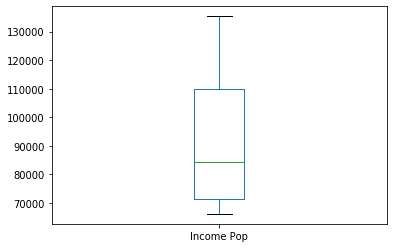

In [542]:
cluster_summary_df[['Income Pop',]].plot(kind='box')

In [543]:
cluster_summary_df[cluster_summary_df['Cluster'] == 1]

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"3,300.80","2,649.00","70,631.45",0.55,33.56,-112.17,1


In [560]:
cluster_1_map

In [553]:
cluster_summary_df[cluster_summary_df['Cluster'] == 2]

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"10,702.11","6,675.78","73,116.33",3.00,33.49,-112.05,2


In [561]:
cluster_2_map

In [547]:
cluster_summary_df[cluster_summary_df['Cluster'] == 3]

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"10,959.17","4,711.46","66,199.29",0.09,33.51,-112.17,3


In [562]:
cluster_3_map

In [556]:
cluster_summary_df[cluster_summary_df['Cluster'] == 4]

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"5,794.87","8,127.33","135,393.00",0.13,33.62,-111.96,4


In [563]:
cluster_4_map

In [551]:
cluster_summary_df[cluster_summary_df['Cluster'] == 5]

,Age Pop,Edu Pop,Income Pop,Med Count,Latitude,Longitude,Cluster
mean,"11,238.50","10,354.14","95,907.50",0.50,33.35,-111.80,5


In [564]:
cluster_5_map